In [1]:
import numpy as np
import pandas as pd
import functions as fnc
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as patches
from torchvision.ops.boxes import batched_nms
from importlib import reload

import math
from sklearn.neighbors import KDTree
import matplotlib.colors as mcolors
from skimage.measure import label, regionprops
import torch
from skimage.color import label2rgb
from skimage.segmentation import clear_border

#import clip
from tqdm import tqdm
from PIL import Image

import json


In [2]:
para={'OutDIR': '/DATA/vito/output/Ravi2_run_dw6/',
      'DataDIR': '/DATA/vito/data/',
      'DatasetName': 'Ravi/*',
      'fid': 0,
      'crop_size': 1024,
      'resample_factor': 1/6
      }
OutDIR=para.get('OutDIR')

with open(OutDIR+'init_para.json', 'r') as json_file:
    init_para = json.load(json_file)
init_para

{'OutDIR': '/DATA/vito/output/Ravi2_run_dw6/',
 'DataDIR': '/DATA/vito/data/',
 'DatasetName': 'Ravi/*',
 'fid': 0,
 'crop_size': 1024,
 'resample_factor': 0.16666666666666666}

In [2]:
if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
else:
    DEVICE = torch.device('cpu')

In [3]:
#OutDIR='/DATA/vito/output/overlap_highestIOU_reseg_edgenobuffer_downsampled2/'
#downsampled=True
OutDIR='/DATA/vito/output/original_SAM/'
downsampled=False

DataDIR='/DATA/vito/data/'
#fn_img = glob.glob(DataDIR+'test_img/*')
fn_img = glob.glob(DataDIR+'drone_ortho/*')
fn_img.sort()

image=(np.load(DataDIR+'example/rgb.npy')*255).astype(np.uint8)
#image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
seg_ids=np.load(DataDIR+'example/segment_ids.npy')

#removing edge ids
for id in np.unique(np.hstack([np.unique(seg_ids[0,:]),np.unique(seg_ids[-1,:]),np.unique(seg_ids[:,0]),np.unique(seg_ids[:,-1])])):
    seg_ids[seg_ids==id]=-1

seg_labels=(np.unique(seg_ids)[1:])

seg_size=[]
for seg in seg_labels:
    seg_size.append(np.sum(seg_ids==seg))

seg_size_sort_idx=np.argsort(seg_size)
list_of_label=[(seg_ids==seg_labels[index]).astype(np.uint8) for index in seg_size_sort_idx]
list_of_label_centroid = [fnc.get_centroid(mask) for mask in list_of_label]

if downsampled:
    pre_para={'Downsample': {'fxy':0.5}}
    image=fnc.preprocessing_roulette(image, pre_para)
    pre_para={'Downsample': {'fxy':0.5, 'method':'nearest'}}
    seg_ids=fnc.preprocessing_roulette(seg_ids, pre_para)

#all_seg=np.load(OutDIR+'all_resized.npy', allow_pickle=True)



In [ ]:
from segment_anything import sam_model_registry, SamPredictor
from segment_anything import SamAutomaticMaskGenerator
import gc

MODEL_TYPE = "vit_h"
if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
    print('Currently running on GPU\nModel '+MODEL_TYPE)
else:
    DEVICE = torch.device('cpu')
    print('Currently running on CPU\nModel '+MODEL_TYPE)

if MODEL_TYPE == 'vit_h':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_h_4b8939.pth'
elif MODEL_TYPE == 'vit_l':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_l_0b3195.pth'
else:
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_b_01ec64.pth'

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(sam)


Currently running on GPU
Model vit_h


In [5]:
gc.collect()
torch.cuda.empty_cache()
pre_para={'Gaussian': {'kernel size':3}
        #'CLAHE':{'clip limit':2}#,
        #'Downsample': {'fxy':4},
        #'Buffering': {'crop size': crop_size}
        }
temp_image=fnc.preprocessing_roulette(image, pre_para)
#SAM segmentation
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=256,
    pred_iou_thresh=0.95,
    stability_score_thresh=0.95,#iou by varying cutoff in binary conversion
    box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
    crop_n_layers=0,#cut into 2**n crops
    crop_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
    crop_n_points_downscale_factor=1,
    crop_overlap_ratio=0,
    #min_mask_region_area=2000,
)

with torch.no_grad():
    masks = mask_generator.generate(temp_image)
print(len(masks))


194


In [6]:
np.save(OutDIR+'original_sam_256spg',masks)

In [4]:
all_reseg=np.load(OutDIR+'all_reseg_mask.npy', allow_pickle=True)
#exclude edge
#ALL_seg=[]
all_mask=[]
pred_iou=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip([mask['segmentation'] for mask in clip_window['mask']], [mask['predicted_iou'] for mask in clip_window['mask']]):
        if not (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            all_mask.append(resize)
            pred_iou.append(score)
        #ALL_seg.append({'mask':resize,'pred_iou':score,'edge':edge})
#stacked_mask=np.sum(all_mask,axis=0)

bboxes = torch.tensor([fnc.find_bounding_boxes(mask) for mask in all_mask], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])
keep = batched_nms(bboxes, scores, labels, 0.3)
masks_nms=[all_mask[i] for i in keep]
pred_iou_nms=[pred_iou[i] for i in keep]
del all_mask,pred_iou

In [5]:
def nms(all_mask,pred_iou, iou=0.3):
    bboxes = torch.tensor([fnc.find_bounding_boxes(mask) for mask in all_mask], device=DEVICE, dtype=torch.float)
    scores = torch.tensor(pred_iou, device=DEVICE, dtype=torch.float)
    labels = torch.zeros_like(bboxes[:, 0])
    keep = batched_nms(bboxes, scores, labels, iou)
    masks_nms=[all_mask[i] for i in keep]
    return masks_nms

In [6]:
modified_masks=np.load('/DATA/vito/output/testing/all_reseg_mask_void_filled.npy', allow_pickle=True)
modified_masks=[mask['mask'] for mask in modified_masks]

In [7]:
ar_mask128_2=[mask['segmentation'] for mask in np.load(OutDIR+'original_sam_128spg_2cp.npy', allow_pickle=True)]
ar_mask256_1=[mask['segmentation'] for mask in np.load(OutDIR+'original_sam_256spg_1cp.npy', allow_pickle=True)]
ar_mask256=[mask['segmentation'] for mask in np.load(OutDIR+'original_sam_256spg.npy', allow_pickle=True)]
ar_mask300=[mask['segmentation'] for mask in np.load(OutDIR+'original_sam_300spg.npy', allow_pickle=True)]

iou128_2=[mask['predicted_iou'] for mask in np.load(OutDIR+'original_sam_128spg_2cp.npy', allow_pickle=True)]
iou256_1=[mask['predicted_iou'] for mask in np.load(OutDIR+'original_sam_256spg_1cp.npy', allow_pickle=True)]
iou256=[mask['predicted_iou'] for mask in np.load(OutDIR+'original_sam_256spg.npy', allow_pickle=True)]
iou300=[mask['predicted_iou'] for mask in np.load(OutDIR+'original_sam_300spg.npy', allow_pickle=True)]

ar_mask128_2_nms=nms(ar_mask128_2,iou128_2,0.2)
ar_mask256_1_nms=nms(ar_mask256_1,iou256_1,0.2)
ar_mask256_nms=nms(ar_mask256,iou256)
ar_mask300_nms=nms(ar_mask300,iou300)

In [9]:
ar_mask128_2_stats=fnc.create_stats_df(ar_mask128_2)
ar_mask256_1_stats=fnc.create_stats_df(ar_mask256_1)
ar_mask256_stats=fnc.create_stats_df(ar_mask256)
ar_mask300_stats=fnc.create_stats_df(ar_mask300)
modified_sam_stats=fnc.create_stats_df(modified_masks)
tiled_stats=fnc.create_stats_df(masks_nms)

del ar_mask128_2,ar_mask256_1,ar_mask256,ar_mask300

In [10]:
ar_mask128_2_nms_stats=fnc.create_stats_df(ar_mask128_2_nms)
ar_mask256_1_nms_stats=fnc.create_stats_df(ar_mask256_1_nms)
ar_mask256_nms_stats=fnc.create_stats_df(ar_mask256_nms)
ar_mask300_nms_stats=fnc.create_stats_df(ar_mask300_nms)

In [11]:
label_stats=fnc.create_stats_df(list_of_label)

In [14]:
tiled_stats.to_hdf(OutDIR+'tiled_stats_df.h5', key='df', mode='w')
ar_mask128_2_stats.to_hdf(OutDIR+'ar_mask128_2_stats_df.h5', key='df', mode='w')
ar_mask256_1_stats.to_hdf(OutDIR+'ar_mask256_1_stats_df.h5', key='df', mode='w')
ar_mask256_stats.to_hdf(OutDIR+'ar_mask256_stats_df.h5', key='df', mode='w')
ar_mask300_stats.to_hdf(OutDIR+'ar_mask300_stats_df.h5', key='df', mode='w')
label_stats.to_hdf(OutDIR+'label_stats_df.h5', key='df', mode='w')
modified_sam_stats.to_hdf('/DATA/vito/output/testing/stats_df.h5', key='df', mode='w')

/tmp/ipykernel_1491221/910731173.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block2_values] [items->Index(['bbox'], dtype='object')]

  tiled_stats.to_hdf(OutDIR+'tiled_stats_df.h5', key='df', mode='w')
/tmp/ipykernel_1491221/910731173.py:2: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block2_values] [items->Index(['bbox'], dtype='object')]

  ar_mask128_2_stats.to_hdf(OutDIR+'ar_mask128_2_stats_df.h5', key='df', mode='w')
/tmp/ipykernel_1491221/910731173.py:3: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block2_values] [items->Index(['bbox'], dtype='object')]

  ar_mask256_1_stats.to_hdf(OutDIR+'ar_mask256_1_stats_df.h5', key='df', mode='w')
/tmp/ipykernel_149122

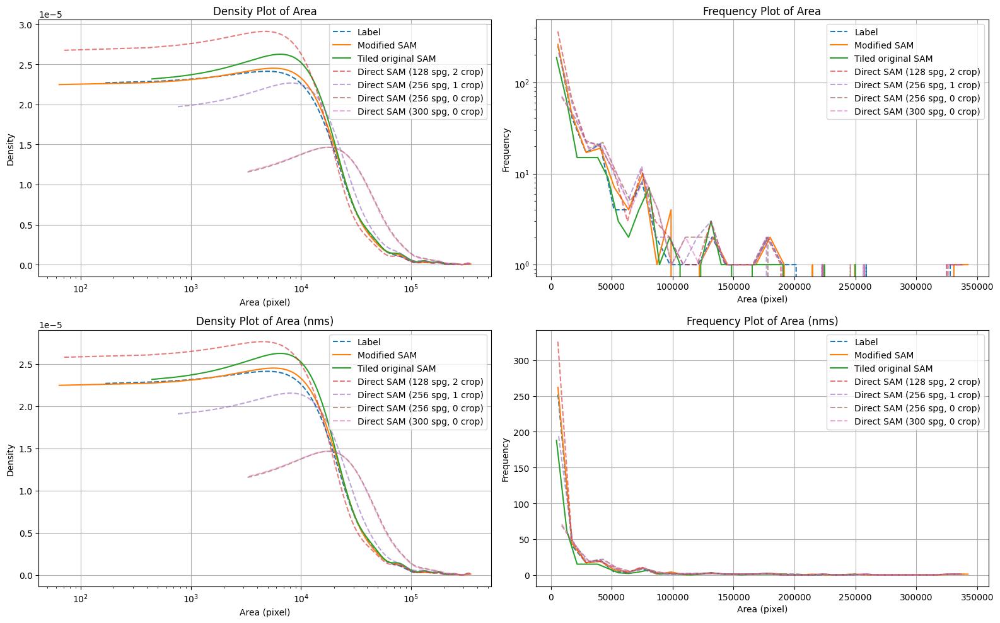

In [15]:
from scipy.stats import gaussian_kde
loged = True 

plt.figure(figsize=(16, 10))

labels=['Label','Modified SAM','Tiled original SAM', 'Direct SAM (128 spg, 2 crop)','Direct SAM (256 spg, 1 crop)'
        ,'Direct SAM (256 spg, 0 crop)','Direct SAM (300 spg, 0 crop)']
c=0

plt.subplot(2,2,1)
for df in [label_stats,modified_sam_stats,tiled_stats,ar_mask128_2_stats,ar_mask256_1_stats,ar_mask256_stats,ar_mask300_stats]:
    if loged:
        plt.xscale('log')
    data = df['area']

    kde = gaussian_kde(data)
    x = np.linspace(min(data), max(data), 1000)
    kde_values = kde(x)
    if c>2:
        plt.plot(x, kde_values, '--', label=labels[c], alpha=0.6)
    elif c>0:
        plt.plot(x, kde_values, label=labels[c])
    else:
        plt.plot(x, kde_values,'--', label=labels[c])
    c+=1

plt.xlabel('Area (pixel)')
plt.ylabel('Density')
plt.title('Density Plot of Area')
plt.legend(loc='upper right')
plt.grid()

plt.subplot(2,2,2)
loged = True
c=0
for df in [label_stats,modified_sam_stats,tiled_stats,ar_mask128_2_stats,ar_mask256_1_stats,ar_mask256_stats,ar_mask300_stats]:
    if loged:
        #plt.xscale('log')
        plt.yscale('log')
    data = df['area']

    frequencies, bin_edges = np.histogram(data, bins=30)
    bin_midpoints = (bin_edges[:-1] + bin_edges[1:]) / 2
    if c>2:
        plt.plot(bin_midpoints, frequencies, '--', label=labels[c], alpha=0.6)
    elif c>0:
        plt.plot(bin_midpoints, frequencies, label=labels[c])
    else:
        plt.plot(bin_midpoints, frequencies, '--', label=labels[c])
    c+=1

plt.xlabel('Area (pixel)')
plt.ylabel('Frequency')
plt.title('Frequency Plot of Area')
plt.legend()
plt.grid()

c=0
loged=True
plt.subplot(2,2,3)
for df in [label_stats,modified_sam_stats,tiled_stats
           ,ar_mask128_2_nms_stats,ar_mask256_1_nms_stats,ar_mask256_nms_stats,ar_mask300_nms_stats]:
    if loged:
        plt.xscale('log')
    data = df['area']

    kde = gaussian_kde(data)
    x = np.linspace(min(data), max(data), 1000)
    kde_values = kde(x)
    if c>2:
        plt.plot(x, kde_values, '--', label=labels[c], alpha=0.6)
    elif c>0:
        plt.plot(x, kde_values, label=labels[c])
    else:
        plt.plot(x, kde_values,'--', label=labels[c])
    c+=1

plt.xlabel('Area (pixel)')
plt.ylabel('Density')
plt.title('Density Plot of Area (nms)')
plt.legend(loc='upper right')
plt.grid()

plt.subplot(2,2,4)
loged = False
c=0
for df in [label_stats,modified_sam_stats,tiled_stats
           ,ar_mask128_2_nms_stats,ar_mask256_1_nms_stats,ar_mask256_nms_stats,ar_mask300_nms_stats]:
    if loged:
        #plt.xscale('log')
        plt.yscale('log')
    data = df['area']

    frequencies, bin_edges = np.histogram(data, bins=30)
    bin_midpoints = (bin_edges[:-1] + bin_edges[1:]) / 2
    if c>2:
        plt.plot(bin_midpoints, frequencies, '--', label=labels[c], alpha=0.6)
    elif c>0:
        plt.plot(bin_midpoints, frequencies, label=labels[c])
    else:
        plt.plot(bin_midpoints, frequencies, '--', label=labels[c])
    c+=1

plt.xlabel('Area (pixel)')
plt.ylabel('Frequency')
plt.title('Frequency Plot of Area (nms)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

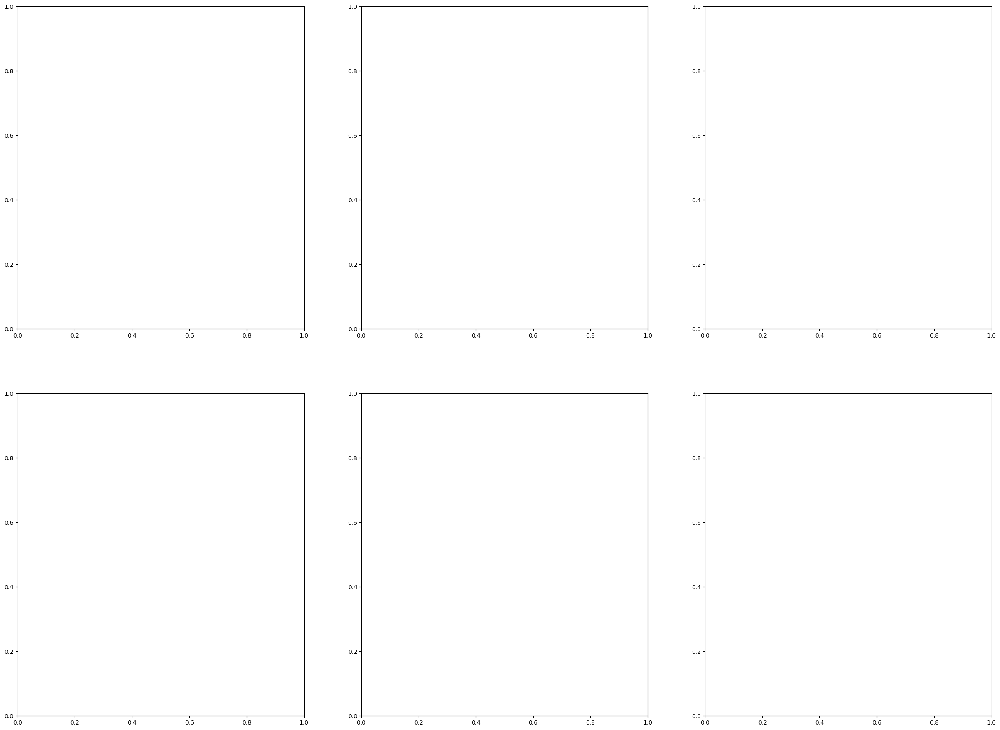

In [11]:
labels=['Modified SAM','Tiled original', 'Direct SAM (128 spg, 2 crop)','Direct SAM (256 spg, 1 crop)'
        ,'Direct SAM (256 spg, 0 crop)','Direct SAM (300 spg, 0 crop)']

c=0
fig,ax=plt.subplots(2,3,figsize=(30,22))
ax=ax.flatten()
for list_of_mask in [modified_masks,masks_nms,ar_mask128_2_nms,ar_mask256_1_nms,ar_mask256_nms,ar_mask300_nms]:
    list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_mask]

    tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
    k=6
    _, ind = tree.query(list_of_label_centroid, k=k)

    # get nearest centroid iou
    kdc_iou=[]
    labelcount=len(list_of_label)
    for match in ind:
        #check if nearest neighbor is not a label
        j=1
        while match[j]<labelcount:
            j+=1
            if j==k:
                break
        if j<k:
            if np.sum(list_of_label[match[0]])>np.sum(list_of_mask[match[j]-labelcount]):
                kdc_iou.append(-fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
            else:
                kdc_iou.append(fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
        else:
            kdc_iou.append(-0.1)
    

    ax[c].imshow(image)

    for i in range(len(list_of_label)):
        contours = plt.contour(list_of_label[i], levels=[0.5], colors='none')

        for contour_path in contours.collections[0].get_paths():
            # hatch option 	{'/', '\', '|', '-', '+', 'x', 'o', 'O', '.', '*'}
            msk_iou=kdc_iou[i]
            if abs(msk_iou)<0.5:#missed
                patch = patches.PathPatch(contour_path, hatch='///', fill=False, edgecolor='red')
            elif (abs(msk_iou)>=0.5 and abs(msk_iou)<0.9):#hit but not perfect
                if msk_iou>0:#overseg
                    patch = patches.PathPatch(contour_path, hatch='||', fill=False, edgecolor='blue')
                elif msk_iou<0:#underseg
                    patch = patches.PathPatch(contour_path, hatch='xx', fill=False, edgecolor='yellow')
            #else:
            #    patch = patches.PathPatch(contour_path, hatch='*', fill=False, edgecolor='green')
            ax[c].add_patch(patch)

    legend_patches = [
        patches.Patch(facecolor='none', hatch='///', edgecolor='red', label='Missed (|iou|: <0.5)'),
        patches.Patch(facecolor='none', hatch='||', edgecolor='blue', label='Overseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='none', hatch='xx', edgecolor='yellow', label='Underseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='none', hatch='*', edgecolor='green', label='Perfect Hit (|iou|: >=0.9)')
    ]
    ax[c].legend(handles=legend_patches, loc='upper right')
    ax[c].set_title(labels[c], fontsize=18)
    ax[c].axis('off')
    c+=1
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

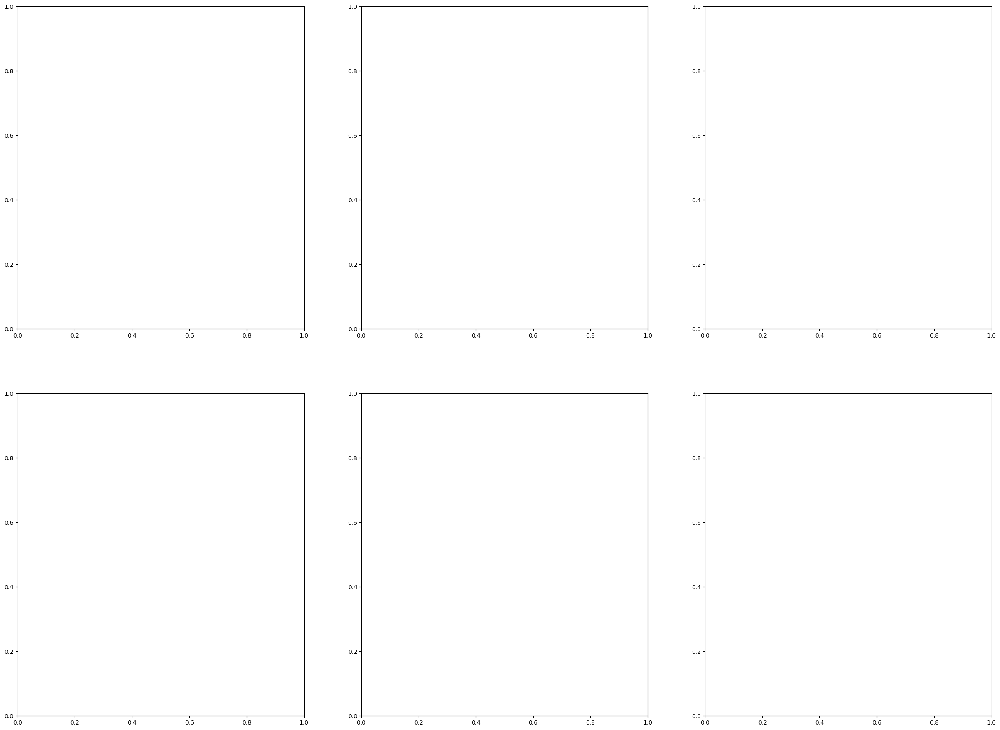

In [10]:
labels=['Modified SAM','Tiled original', 'Direct SAM (128 spg, 2 crop)','Direct SAM (256 spg, 1 crop)'
        ,'Direct SAM (256 spg, 0 crop)','Direct SAM (300 spg, 0 crop)']

c=0
fig,ax=plt.subplots(2,3,figsize=(30,22))
ax=ax.flatten()
for list_of_mask in [modified_masks,masks_nms,ar_mask128_2_nms,ar_mask256_1_nms,ar_mask256_nms,ar_mask300_nms]:
    list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_mask]

    tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
    k=6
    _, ind = tree.query(list_of_label_centroid, k=k)

    # get nearest centroid iou
    kdc_iou=[]
    labelcount=len(list_of_label)
    for match in ind:
        #check if nearest neighbor is not a label
        j=1
        while match[j]<labelcount:
            j+=1
            if j==k:
                break
        if j<k:
            if np.sum(list_of_label[match[0]])>np.sum(list_of_mask[match[j]-labelcount]):
                kdc_iou.append(-fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
            else:
                kdc_iou.append(fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
        else:
            kdc_iou.append(-0.1)
    

    ax[c].imshow(image)

    for i in range(len(list_of_label)):
        contours = plt.contour(list_of_label[i], levels=[0.5], colors='none')

        for contour_path in contours.collections[0].get_paths():
            # hatch option 	{'/', '\', '|', '-', '+', 'x', 'o', 'O', '.', '*'}
            msk_iou=kdc_iou[i]
            if abs(msk_iou)<0.5:#missed
                patch = patches.PathPatch(contour_path, fill=True, facecolor='red', edgecolor='k',alpha=0.4)
            elif (abs(msk_iou)>=0.5 and abs(msk_iou)<0.9):#hit but not perfect
                if msk_iou>0:#overseg
                    patch = patches.PathPatch(contour_path, fill=True, facecolor='blue', edgecolor='k',alpha=0.4)
                elif msk_iou<0:#underseg
                    patch = patches.PathPatch(contour_path, fill=True, facecolor='yellow', edgecolor='k',alpha=0.4)
            #else:
            #    patch = patches.PathPatch(contour_path, hatch='*', fill=False, edgecolor='green')
            ax[c].add_patch(patch)

    legend_patches = [
        patches.Patch(facecolor='red', edgecolor='k', label='Missed (|iou|: <0.5)'),
        patches.Patch(facecolor='blue', edgecolor='k', label='Overseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='yellow', edgecolor='k', label='Underseg (|iou|: 0.5-0.9)'),
        #patches.Patch(facecolor='none', edgecolor='green', label='Perfect Hit (|iou|: >=0.9)')
    ]
    ax[c].legend(handles=legend_patches, loc='upper right')
    ax[c].set_title(labels[c], fontsize=18)
    ax[c].axis('off')
    c+=1
plt.tight_layout()
plt.show()

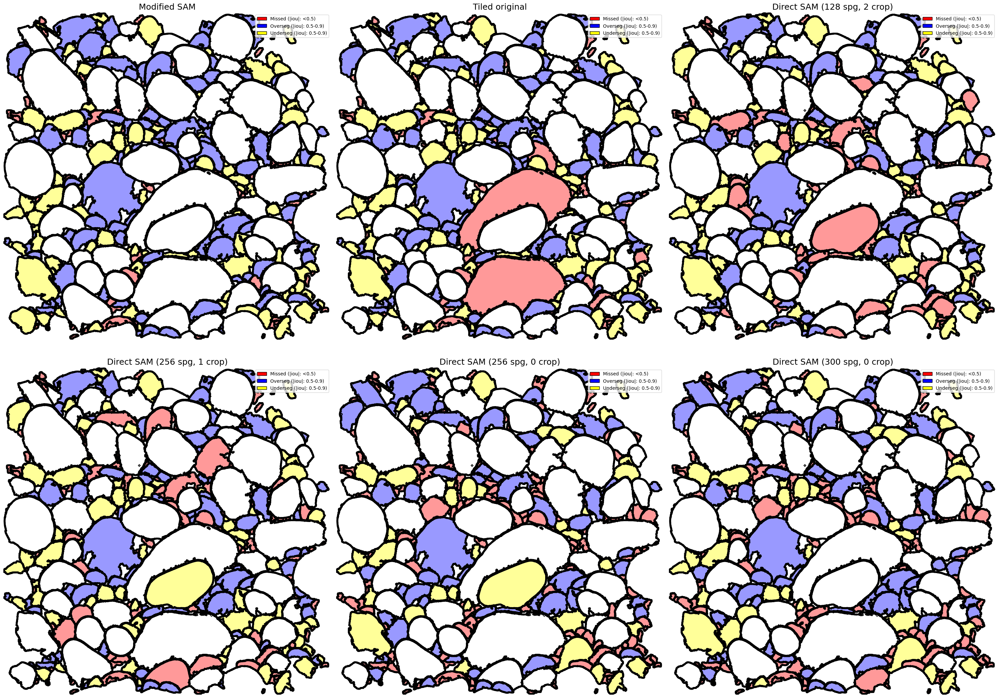

In [18]:
labels=['Modified SAM','Tiled original', 'Direct SAM (128 spg, 2 crop)','Direct SAM (256 spg, 1 crop)'
        ,'Direct SAM (256 spg, 0 crop)','Direct SAM (300 spg, 0 crop)']

c=0
fig,ax=plt.subplots(2,3,figsize=(30,22))
ax=ax.flatten()

for list_of_mask in [modified_masks,masks_nms,ar_mask128_2_nms,ar_mask256_1_nms,ar_mask256_nms,ar_mask300_nms]:
    list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_mask]

    tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
    k=6
    _, ind = tree.query(list_of_label_centroid, k=k)

    # get nearest centroid iou
    kdc_iou=[]
    labelcount=len(list_of_label)
    for match in ind:
        #check if nearest neighbor is not a label
        j=1
        while match[j]<labelcount:
            j+=1
            if j==k:
                break
        if j<k:
            if np.sum(list_of_label[match[0]])>np.sum(list_of_mask[match[j]-labelcount]):
                kdc_iou.append(-fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
            else:
                kdc_iou.append(fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
        else:
            kdc_iou.append(-0.1)
    

    ax[c].imshow(np.zeros((3000,3000)), cmap='binary')

    for i in range(len(list_of_label)):
        contours = plt.contour(list_of_label[i], levels=[0.5], colors='none')

        for contour_path in contours.collections[0].get_paths():
            # hatch option 	{'/', '\', '|', '-', '+', 'x', 'o', 'O', '.', '*'}
            msk_iou=kdc_iou[i]
            if abs(msk_iou)<0.5:#missed
                patch1 = patches.PathPatch(contour_path, fill=True, facecolor='red', edgecolor='k',alpha=0.4)
                patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=4)
            elif (abs(msk_iou)>=0.5 and abs(msk_iou)<0.9):#hit but not perfect
                if msk_iou>0:#overseg
                    patch1 = patches.PathPatch(contour_path, fill=True, facecolor='blue', edgecolor='k',alpha=0.4)
                    patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=4)
                elif msk_iou<0:#underseg
                    patch1 = patches.PathPatch(contour_path, fill=True, facecolor='yellow', edgecolor='k',alpha=0.4)
                    patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=4)
            else:
                patch1 = patches.PathPatch(contour_path, fill=False, edgecolor='k')
                patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=4)
            ax[c].add_patch(patch1)
            ax[c].add_patch(patch2)

    legend_patches = [
        patches.Patch(facecolor='red', edgecolor='k',linewidth=4, label='Missed (|iou|: <0.5)'),
        patches.Patch(facecolor='blue', edgecolor='k',linewidth=4, label='Overseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='yellow', edgecolor='k',linewidth=4, label='Underseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='none', edgecolor='k',linewidth=4, label='Perfect Hit (|iou|: >=0.9)')
    ]
    ax[c].legend(handles=legend_patches, loc='upper right')
    ax[c].set_title(labels[c], fontsize=18)
    ax[c].axis('off')
    c+=1
plt.tight_layout()
plt.show()

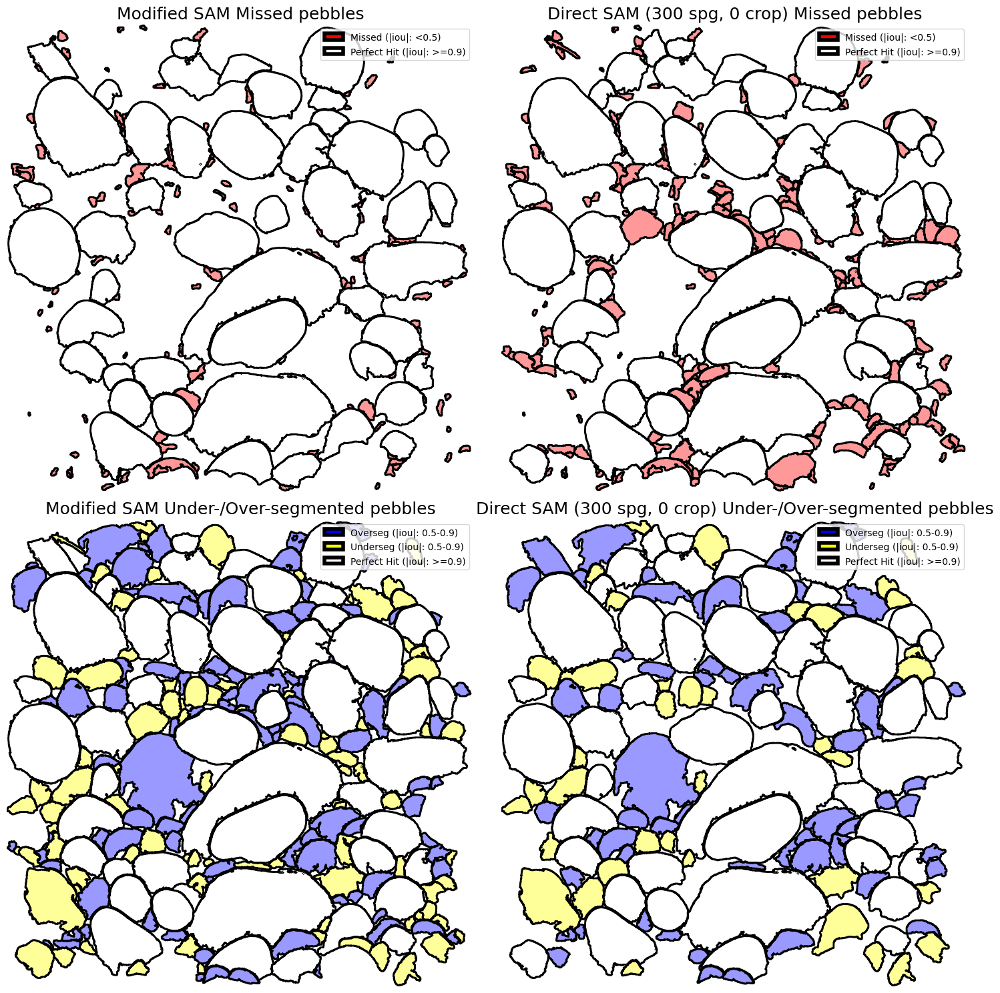

In [24]:
labels=['Modified SAM','Direct SAM (300 spg, 0 crop)']

c=0
fig,ax=plt.subplots(2,2,figsize=(15,15))
ax=ax.flatten()
lw=2

for list_of_mask in [modified_masks,ar_mask300_nms]:
    list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_mask]

    tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
    k=6
    _, ind = tree.query(list_of_label_centroid, k=k)

    # get nearest centroid iou
    kdc_iou=[]
    labelcount=len(list_of_label)
    for match in ind:
        #check if nearest neighbor is not a label
        j=1
        while match[j]<labelcount:
            j+=1
            if j==k:
                break
        if j<k:
            if np.sum(list_of_label[match[0]])>np.sum(list_of_mask[match[j]-labelcount]):
                kdc_iou.append(-fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
            else:
                kdc_iou.append(fnc.iou(list_of_label[match[0]],list_of_mask[match[j]-labelcount]))
        else:
            kdc_iou.append(-0.1)
    

    ax[c].imshow(np.zeros((3000,3000)), cmap='binary')
    ax[c+2].imshow(np.zeros((3000,3000)), cmap='binary')

    for i in range(len(list_of_label)):
        contours = plt.contour(list_of_label[i], levels=[0.5], colors='none')

        for contour_path in contours.collections[0].get_paths():
            # hatch option 	{'/', '\', '|', '-', '+', 'x', 'o', 'O', '.', '*'}
            msk_iou=kdc_iou[i]
            if abs(msk_iou)<0.5:#missed
                patch1 = patches.PathPatch(contour_path, fill=True, facecolor='red', edgecolor='k',alpha=0.4)
                patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=lw)
                ax[c].add_patch(patch1)
                ax[c].add_patch(patch2)
                #ax[c+2].add_patch(patch2)
            elif (abs(msk_iou)>=0.5 and abs(msk_iou)<0.9):#hit but not perfect
                if msk_iou>0:#overseg
                    patch1 = patches.PathPatch(contour_path, fill=True, facecolor='blue', edgecolor='k',alpha=0.4)
                    patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=lw)
                elif msk_iou<0:#underseg
                    patch1 = patches.PathPatch(contour_path, fill=True, facecolor='yellow', edgecolor='k',alpha=0.4)
                    patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=lw)
                #ax[c].add_patch(patch2)
                ax[c+2].add_patch(patch1)
                ax[c+2].add_patch(patch2)
            else:
                patch1 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=lw)
                patch2 = patches.PathPatch(contour_path, fill=False, edgecolor='k',linewidth=lw)
                ax[c].add_patch(patch1)
                #ax[c].add_patch(patch2)
                #ax[c+2].add_patch(patch1)
                ax[c+2].add_patch(patch2)

    legend_patches = [
        patches.Patch(facecolor='red', edgecolor='k',linewidth=4, label='Missed (|iou|: <0.5)'),
        #patches.Patch(facecolor='blue', edgecolor='k', label='Overseg (|iou|: 0.5-0.9)'),
        #patches.Patch(facecolor='yellow', edgecolor='k', label='Underseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='none', edgecolor='k',linewidth=4, label='Perfect Hit (|iou|: >=0.9)')
    ]
    ax[c].legend(handles=legend_patches, loc='upper right')
    ax[c].set_title(labels[c]+' Missed pebbles', fontsize=18)
    ax[c].axis('off')
    legend_patches = [
        #patches.Patch(facecolor='red', edgecolor='k', label='Missed (|iou|: <0.5)'),
        patches.Patch(facecolor='blue', edgecolor='k',linewidth=4, label='Overseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='yellow', edgecolor='k',linewidth=4, label='Underseg (|iou|: 0.5-0.9)'),
        patches.Patch(facecolor='none', edgecolor='k',linewidth=4, label='Perfect Hit (|iou|: >=0.9)')
    ]
    ax[c+2].legend(handles=legend_patches, loc='upper right')
    ax[c+2].set_title(labels[c]+' Under-/Over-segmented pebbles', fontsize=18)
    ax[c+2].axis('off')
    c+=1
plt.tight_layout()
plt.show()

In [11]:
labels=['Modified SAM','Tiled original', 'Direct SAM (128 spg, 2 crop)','Direct SAM (256 spg, 1 crop)'
        ,'Direct SAM (256 spg, 0 crop)','Direct SAM (300 spg, 0 crop)']

c=0
fig,ax=plt.subplots(2,3,figsize=(30,22))
ax=ax.flatten()
for list_of_mask in [modified_masks,masks_nms,ar_mask128_2_nms,ar_mask256_1_nms,ar_mask256_nms,ar_mask300_nms]:
    
    ax[c].imshow(image)
    fnc.show_anns_array(np.stack(list_of_mask).astype(int),ax[c])
    ax[c].set_title(labels[c], fontsize=18)
    ax[c].axis('off')
    c+=1
plt.tight_layout()
plt.show()

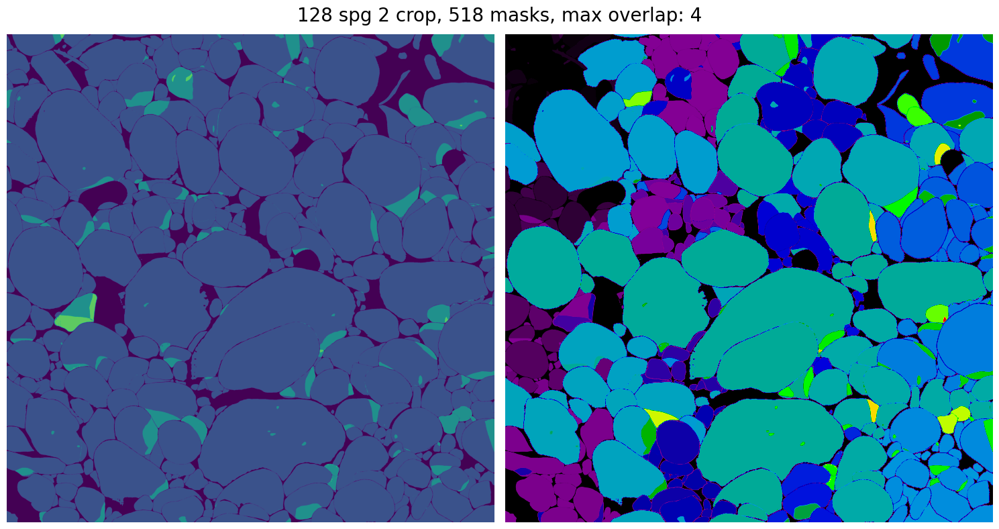

In [9]:
st_msk=np.sum(ar_mask128_2,axis=0)
plt.figure(figsize=(15,8))
#plt.imshow(image)
plt.subplot(1,2,1)
plt.imshow(st_msk)
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(np.sum([ar_mask128_2[i]*(i+1) for i in range(len(ar_mask128_2))],axis=0), cmap='nipy_spectral')
plt.axis('off')

plt.suptitle(f'128 spg 2 crop, {len(ar_mask128_2)} masks, max overlap: {np.max(st_msk)}', fontsize=20)
plt.tight_layout()
plt.show()

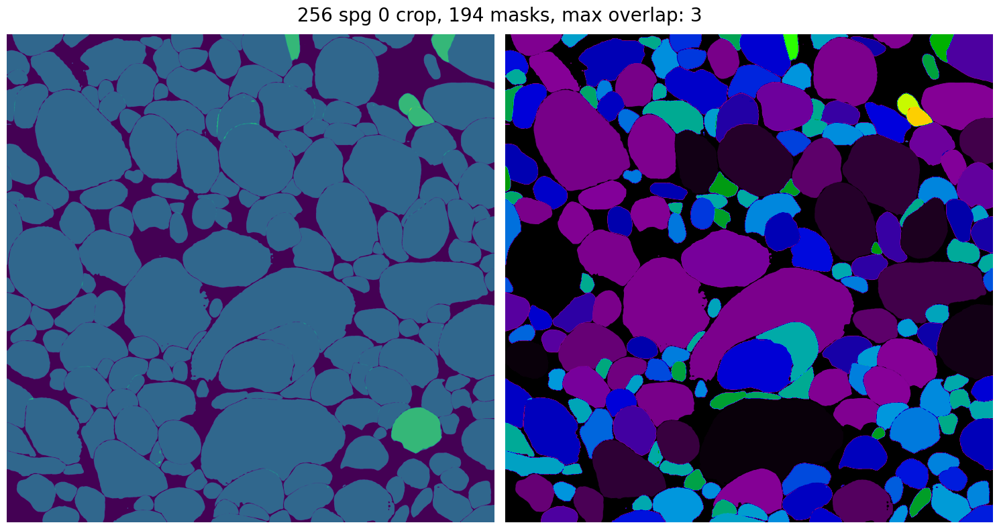

In [16]:
st_msk=np.sum([mask['segmentation'] for mask in masks],axis=0)
plt.figure(figsize=(15,8))
#plt.imshow(image)
plt.subplot(1,2,1)
plt.imshow(st_msk)
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(np.sum([masks[i]['segmentation']*(i+1) for i in range(len(masks))],axis=0), cmap='nipy_spectral')
plt.axis('off')

plt.suptitle(f'256 spg 0 crop, {len(masks)} masks, max overlap: {np.max(st_msk)}', fontsize=20)
plt.tight_layout()
plt.show()

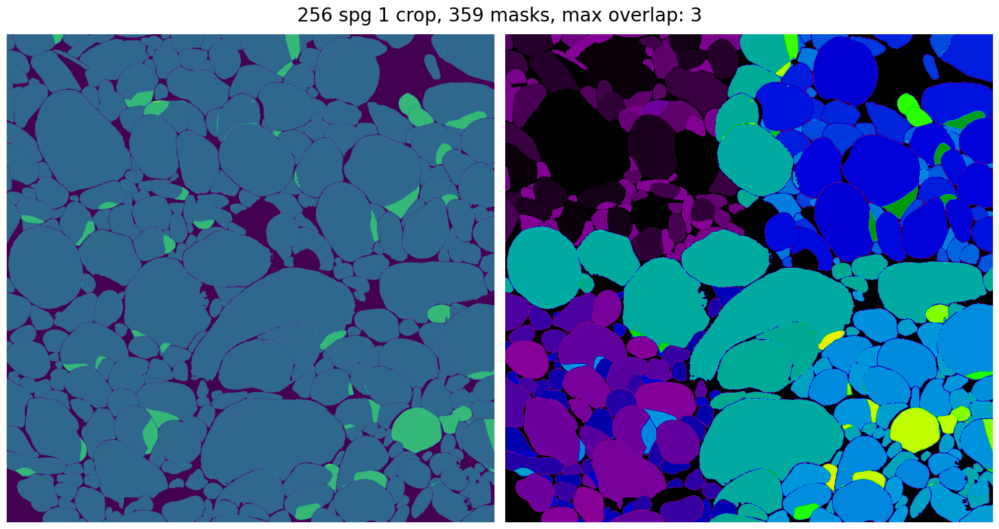

In [19]:
masks=np.load(OutDIR+'original_sam_256spg_1cp.npy', allow_pickle=True)
st_msk=np.sum([mask['segmentation'] for mask in masks],axis=0)
plt.figure(figsize=(15,8))
#plt.imshow(image)
plt.subplot(1,2,1)
plt.imshow(st_msk)
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(np.sum([masks[i]['segmentation']*(i+1) for i in range(len(masks))],axis=0), cmap='nipy_spectral')
plt.axis('off')

plt.suptitle(f'256 spg 1 crop, {len(masks)} masks, max overlap: {np.max(st_msk)}', fontsize=20)
plt.tight_layout()
plt.show()

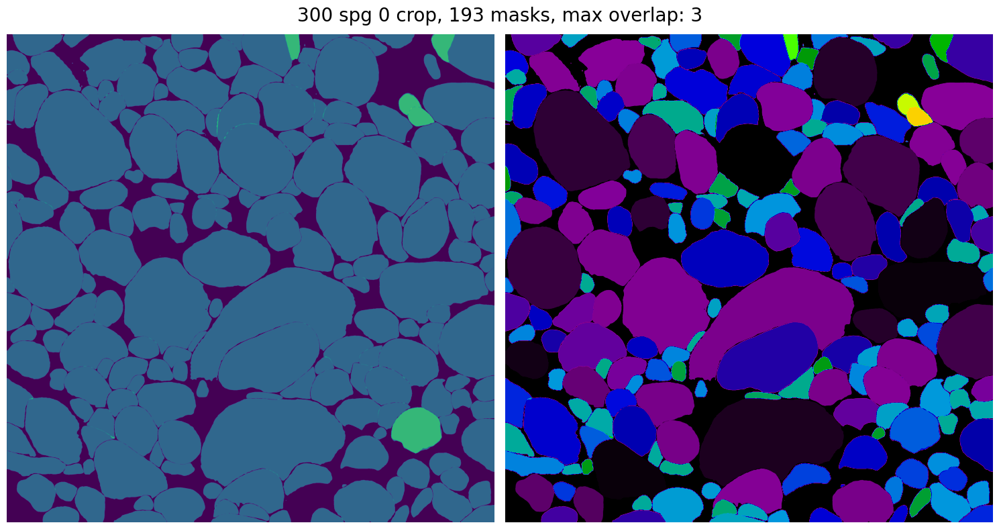

In [20]:
masks=np.load(OutDIR+'original_sam_300spg.npy', allow_pickle=True)
st_msk=np.sum([mask['segmentation'] for mask in masks],axis=0)
plt.figure(figsize=(15,8))
#plt.imshow(image)
plt.subplot(1,2,1)
plt.imshow(st_msk)
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(np.sum([masks[i]['segmentation']*(i+1) for i in range(len(masks))],axis=0), cmap='nipy_spectral')
plt.axis('off')

plt.suptitle(f'300 spg 0 crop, {len(masks)} masks, max overlap: {np.max(st_msk)}', fontsize=20)
plt.tight_layout()
plt.show()

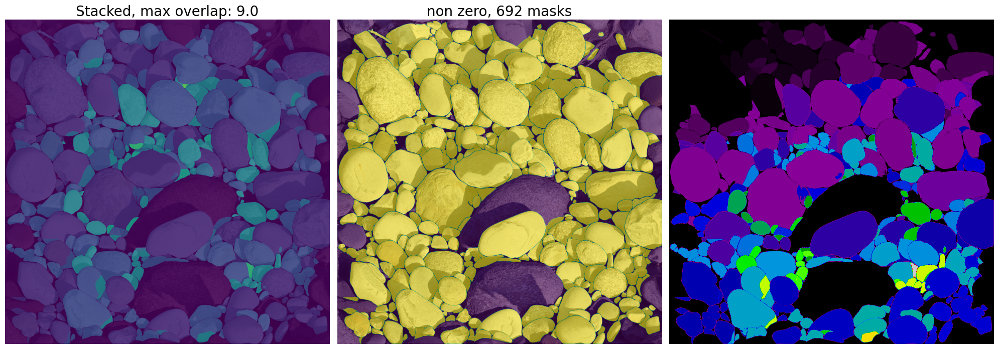

In [33]:
plt.figure(figsize=(20,15))
plt.subplot(1,3,1)
plt.imshow(image)
plt.imshow(stacked_mask,alpha=0.9)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_mask)}', fontsize=20)
plt.subplot(1,3,2)
plt.imshow(image)
plt.imshow(stacked_mask!=0,alpha=0.6)
plt.axis('off')
plt.title(f'non zero, {len(all_mask)} masks', fontsize=20)
plt.subplot(1,3,3)
plt.imshow(np.sum([all_mask[i]*(i+1) for i in range(len(all_mask))],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.tight_layout()
plt.show()

In [27]:
stacked_mask_nms=np.sum(masks_nms,axis=0)

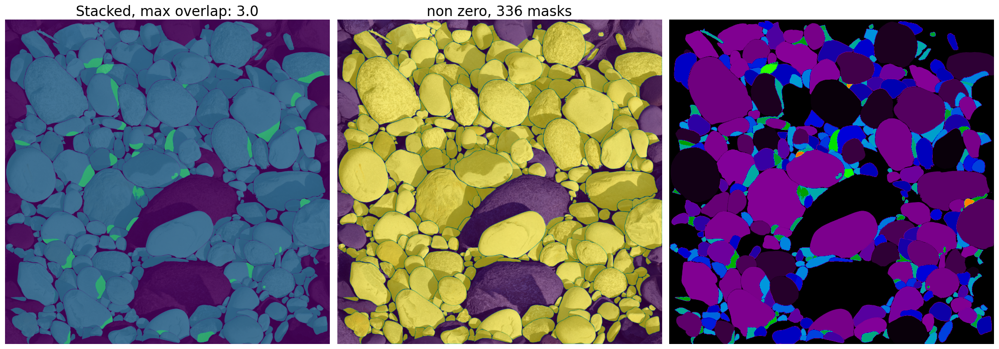

In [32]:
plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.imshow(image)
plt.imshow(stacked_mask_nms,alpha=0.9)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_mask_nms)}', fontsize=20)
plt.subplot(1,3,2)
plt.imshow(image)
plt.imshow(stacked_mask_nms!=0,alpha=0.6)
plt.axis('off')
plt.title(f'non zero, {len(masks_nms)} masks', fontsize=20)
plt.subplot(1,3,3)
plt.imshow(np.sum([masks_nms[i]*(i+1) for i in range(len(masks_nms))],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
#merging edge
#ALL_seg=[]
all_mask=[]
all_edge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip([mask['segmentation'] for mask in clip_window['mask']], [mask['predicted_iou'] for mask in clip_window['mask']]):
        if (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            all_mask.append(resize)
        #ALL_seg.append({'mask':resize,'pred_iou':score,'edge':edge})

In [6]:
#ALL_seg=[]
all_mask=[]
all_edge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip([mask['segmentation'] for mask in clip_window['mask']], [mask['predicted_iou'] for mask in clip_window['mask']]):
        if (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            edge=True
        else:
            edge=False
        resize=np.zeros(image.shape[:-1])
        Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
        if Valid_area==(crop_size,crop_size):
            resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
        else:
            resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
        all_mask.append(resize)
        all_edge.append(edge)
        #ALL_seg.append({'mask':resize,'pred_iou':score,'edge':edge})

In [7]:
stacked_mask=np.sum(all_mask,axis=0)

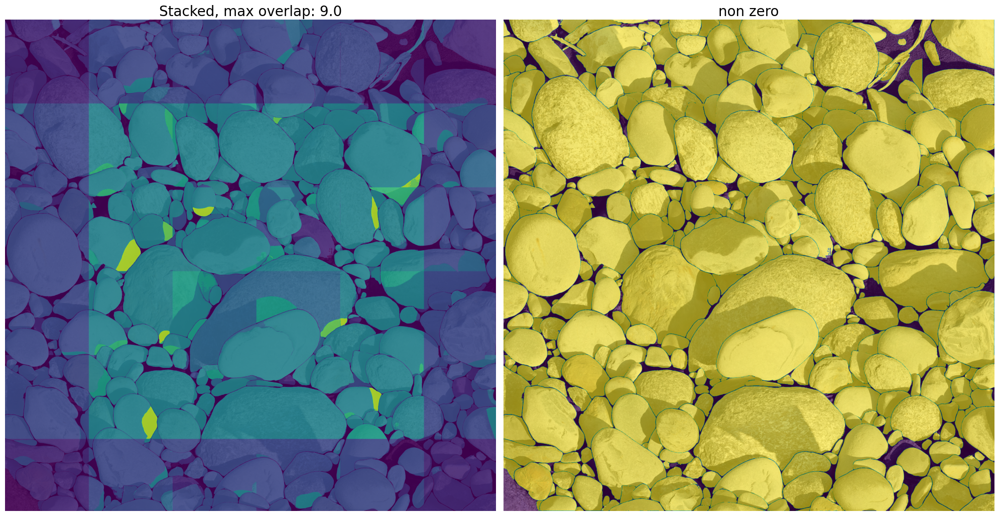

In [9]:
plt.figure(figsize=(20,15))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(stacked_mask,alpha=0.9)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_mask)}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(stacked_mask!=0,alpha=0.6)
plt.axis('off')
plt.title('non zero', fontsize=20)
plt.tight_layout()
plt.show()

In [6]:
bboxes = torch.tensor([fnc.find_bounding_boxes(mask) for mask in Aggregate_masks], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])
keep = batched_nms(bboxes, scores, labels, 0.3)
Aggregate_masks_nms=[Aggregate_masks[i] for i in keep]
pred_iou_nms=[pred_iou[i] for i in keep]

In [7]:
stacked_Aggregate_masks_nms=np.sum(Aggregate_masks_nms,axis=0)

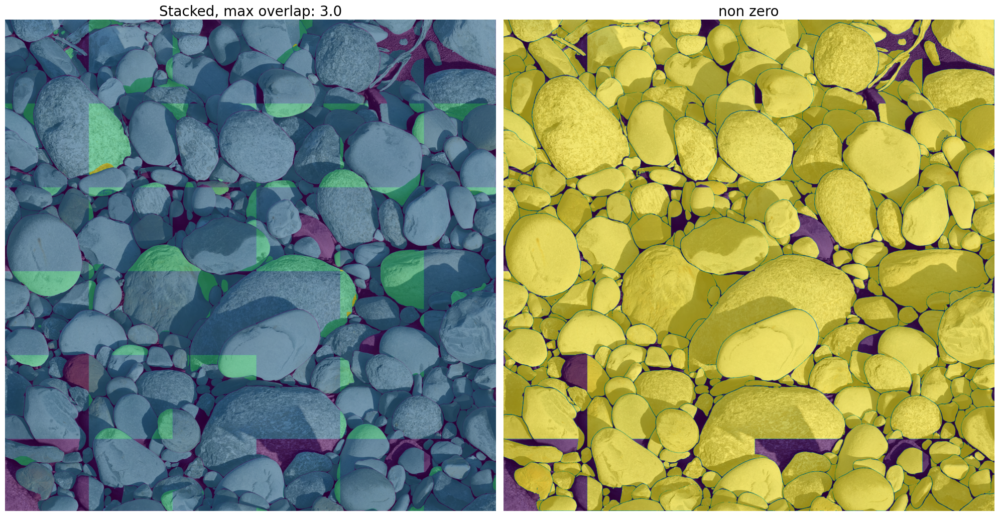

In [8]:
plt.figure(figsize=(20,15))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_nms,alpha=0.6)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_Aggregate_masks_nms)}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_nms!=0,alpha=0.6)
plt.axis('off')
plt.title('non zero', fontsize=20)
plt.tight_layout()

In [9]:
Aggregate_masks_noedge=[]
pred_iou_noedge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip(clip_window['mask'], clip_window['mask pred iou']):
        if not (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            Aggregate_masks_noedge.append(resize)
            pred_iou_noedge.append(score)
#del all_reseg

In [10]:
stacked_Aggregate_masks_noedge=np.sum(Aggregate_masks_noedge,axis=0)

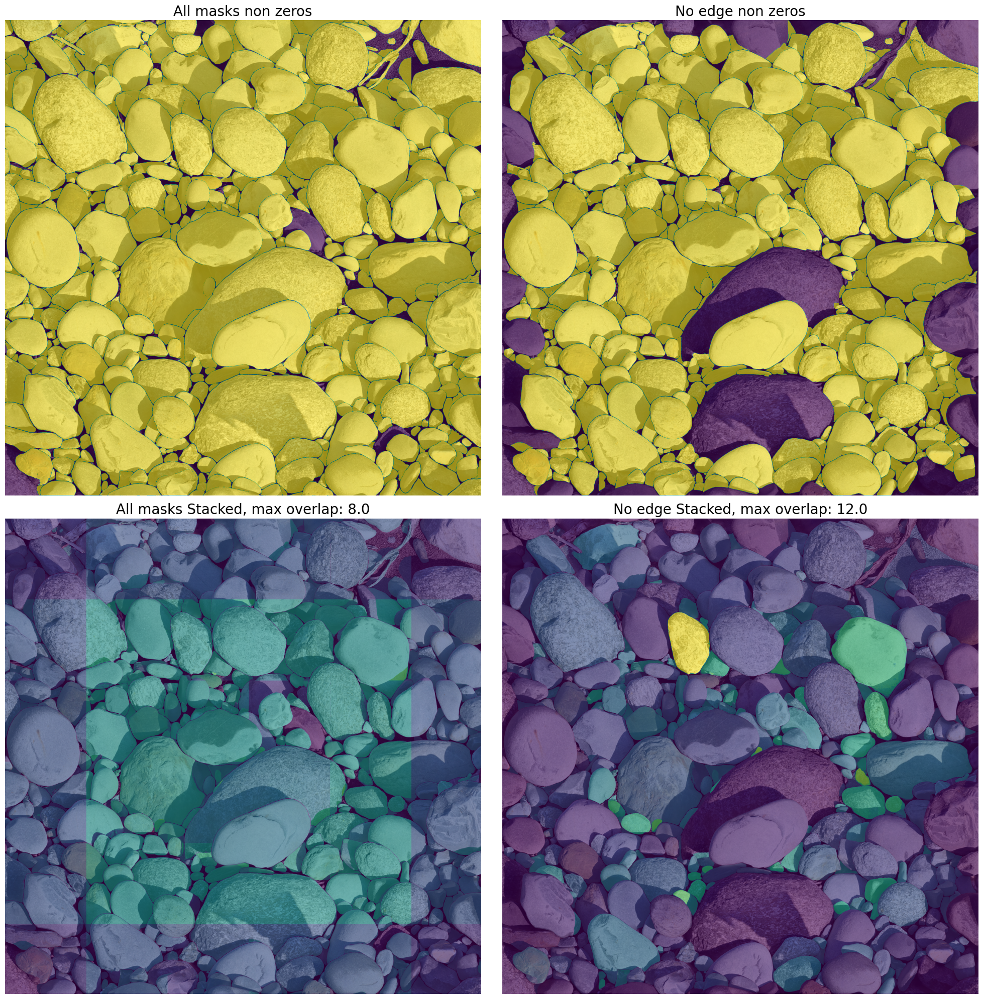

In [11]:
plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks!=0,alpha=0.6)
plt.axis('off')
plt.title('All masks non zeros', fontsize=20)
plt.subplot(2,2,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge!=0,alpha=0.6)
plt.axis('off')
plt.title('No edge non zeros', fontsize=20)
plt.subplot(2,2,3)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks,alpha=0.6)
plt.axis('off')
plt.title(f'All masks Stacked, max overlap: {np.max(stacked_Aggregate_masks)}', fontsize=20)
plt.subplot(2,2,4)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge,alpha=0.6)
plt.axis('off')
plt.title(f'No edge Stacked, max overlap: {np.max(stacked_Aggregate_masks_noedge)}', fontsize=20)
plt.tight_layout()
plt.show()

In [12]:
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in Aggregate_masks_noedge], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou_noedge, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])

In [13]:
keep = batched_nms(bboxes, scores, labels, 0.35)#was 0.3
Aggregate_masks_noedge_nms=[Aggregate_masks_noedge[i] for i in keep]
pred_iou_noedge_nms=[pred_iou_noedge[i] for i in keep]

In [14]:
stacked_Aggregate_masks_noedge_nms=np.sum(Aggregate_masks_noedge_nms,axis=0)

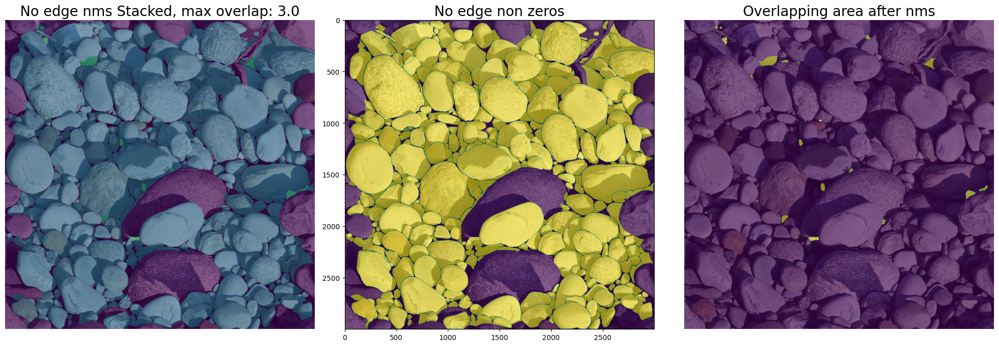

In [15]:
plt.figure(figsize=(20,15))
plt.subplot(1,3,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms,alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked, max overlap: {np.max(stacked_Aggregate_masks_noedge_nms)}', fontsize=20)
plt.subplot(1,3,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms!=0,alpha=0.6)
#plt.axis('off')
plt.title('No edge non zeros', fontsize=20)
plt.subplot(1,3,3)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms', fontsize=20)
plt.tight_layout()
plt.show()

In [16]:
#clear RAM
del pred_iou,bboxes,scores,labels,keep,Aggregate_masks_nms,pred_iou_nms,stacked_Aggregate_masks_nms
del Aggregate_masks,stacked_Aggregate_masks
del Aggregate_masks_noedge, pred_iou_noedge

In [17]:
list_of_mask_centroid = [fnc.get_centroid(mask) for mask in Aggregate_masks_noedge_nms]
ar_masks=np.stack(Aggregate_masks_noedge_nms)
del Aggregate_masks_noedge_nms

In [18]:
from skimage.morphology import binary_dilation
kernel = np.ones((5, 5), np.uint8)
stacked_Aggregate_masks_noedge_nms_eroded=binary_dilation(stacked_Aggregate_masks_noedge_nms>=1, kernel)
 
#stacked_Aggregate_masks_noedge_nms_eroded = cv2.dilate(stacked_Aggregate_masks_noedge_nms==1, kernel, iterations=1) 
no_mask_area=label(stacked_Aggregate_masks_noedge_nms_eroded,1,False,1)

In [19]:
regions=regionprops(no_mask_area)
for i,region in enumerate(regions):
    # take regions with large enough areas
    if (region.area <= 10000):
        no_mask_area[no_mask_area==(i+1)]=0
    else:
        mask=np.array(no_mask_area==(i+1))
        if (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            no_mask_area[no_mask_area==(i+1)]=0
np.unique(no_mask_area)

array([  0, 326, 473], dtype=int32)

In [20]:
flt_no_mask_area=label(no_mask_area)
np.unique(flt_no_mask_area)
del no_mask_area

Text(0.5, 1.0, 'Void in clean SAM masks')

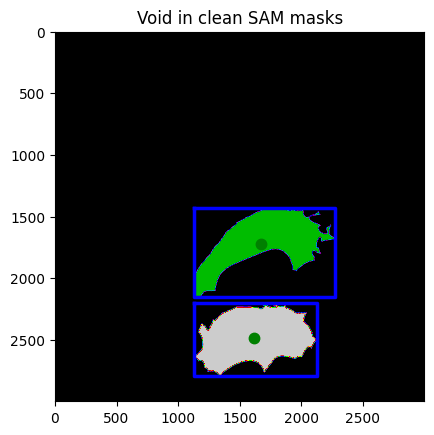

In [45]:
plt.imshow(flt_no_mask_area, cmap='nipy_spectral')
regions=regionprops(flt_no_mask_area)
list_of_no_mask_area_centroid=[]
list_of_no_mask_area_mask=[]
for i,region in enumerate(regions):
    #if i>0:
    y0, x0 =region.centroid
    list_of_no_mask_area_centroid.append((y0,x0))
    list_of_no_mask_area_mask.append(flt_no_mask_area==(i+1))
    
    plt.plot(x0, y0, '.g', markersize=15)
    minr, minc, maxr, maxc = region.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    plt.plot(bx, by, '-b', linewidth=2.5)
ar_no_mask_area=np.stack(list_of_no_mask_area_mask)
plt.title('Void in clean SAM masks')


In [22]:
#fill in holes with downsampled segmentation
OutDIR='/DATA/vito/output/overlap_highestIOU_reseg_edgenobuffer_downsampled2/'
all_reseg=np.load(OutDIR+'all_reseg_mask.npy', allow_pickle=True)
image=(np.load(DataDIR+'example/rgb.npy')*255).astype(np.uint8)
fxy=0.5
pre_para={'Downsample': {'fxy':fxy}}
image_dw=fnc.preprocessing_roulette(image, pre_para)

Aggregate_masks_noedge=[]
pred_iou_noedge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip(clip_window['mask'], clip_window['mask pred iou']):
        if not (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image_dw.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            Aggregate_masks_noedge.append(resize)
            pred_iou_noedge.append(score)

#nms       
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in Aggregate_masks_noedge], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou_noedge, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])

keep = batched_nms(bboxes, scores, labels, 0.35)#was 0.3
Aggregate_masks_noedge_nms=[Aggregate_masks_noedge[i] for i in keep]
del Aggregate_masks_noedge, pred_iou_noedge

#finding best matching centroid
list_of_mask_centroid_dw = [fnc.get_centroid(mask) for mask in Aggregate_masks_noedge_nms]
ar_masks_dw=np.stack(Aggregate_masks_noedge_nms)
del Aggregate_masks_noedge_nms

list_of_no_mask_area_centroid_dw=[]
for y,x in list_of_no_mask_area_centroid:
    list_of_no_mask_area_centroid_dw.append((y*fxy,x*fxy))

tree = KDTree(list_of_no_mask_area_centroid_dw+list_of_mask_centroid_dw)              
k=6
_, ind = tree.query(list_of_no_mask_area_centroid_dw, k=k)

# get nearest centroid iou
kdc_iou=[]
nearest_mask_pick=[]
labelcount=ar_no_mask_area.shape[0]
for match in ind:
    #check if nearest neighbor is not a label
    j=1
    while match[j]<labelcount:
        j+=1
        if j==k:
            break
    if j<k:
        matching_mask=fnc.downsample_fnc(ar_masks_dw[match[j]-labelcount],{'fxy':2}).astype(int)
        if np.sum(ar_no_mask_area[match[0]])>np.sum(matching_mask):
            kdc_iou.append(-fnc.iou(ar_no_mask_area[match[0]],matching_mask))
            nearest_mask_pick.append(matching_mask)
        else:
            kdc_iou.append(fnc.iou(ar_no_mask_area[match[0]],matching_mask))
            nearest_mask_pick.append(matching_mask)
    else:
        kdc_iou.append(-0.1)
        nearest_mask_pick.append(0)
        
del ar_masks_dw, all_reseg,list_of_mask_centroid_dw

In [23]:
ar_masks=np.vstack((ar_masks,np.stack(nearest_mask_pick)))
list_of_mask_centroid = [fnc.get_centroid(ar_masks[i]) for i in range(ar_masks.shape[0])]


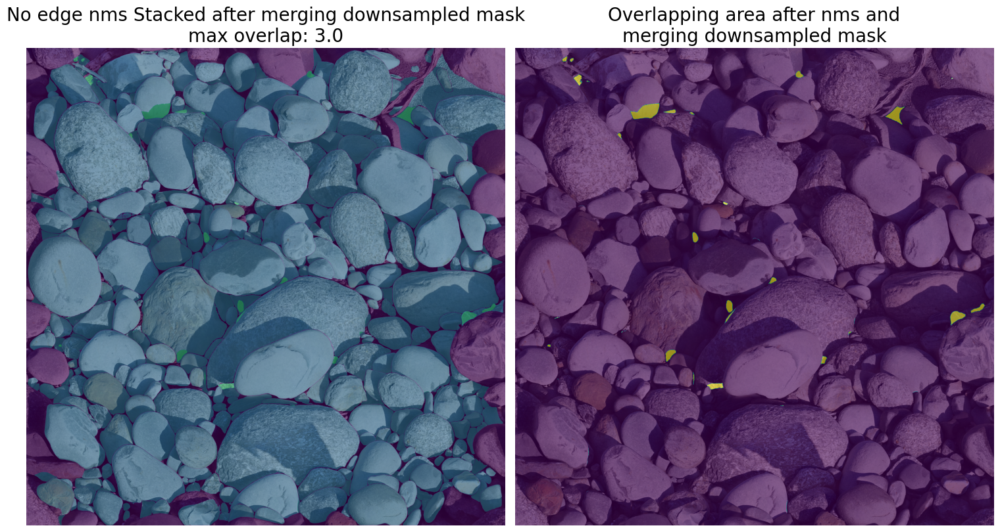

In [24]:
plt.figure(figsize=(15,10))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0),alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked after merging downsampled mask\nmax overlap: {np.max(np.sum(ar_masks,axis=0))}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0)>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms and\nmerging downsampled mask', fontsize=20)
plt.tight_layout()
plt.show()

In [25]:
seg_labels=(np.unique(seg_ids)[1:])

seg_size=[]
for seg in seg_labels:
    seg_size.append(np.sum(seg_ids==seg))

seg_size_sort_idx=np.argsort(seg_size)

list_of_label=[(seg_ids==seg_labels[index]).astype(np.uint8) for index in seg_size_sort_idx]
list_of_label_centroid = [fnc.get_centroid(mask) for mask in list_of_label]
ar_label=np.stack(list_of_label)
del list_of_label

#ar_all=np.stack(list_of_label+Aggregate_masks_noedge_nms)
#list_of_centroid = [fnc.get_centroid(ar_all[i]) for i in range(len(ar_all))]

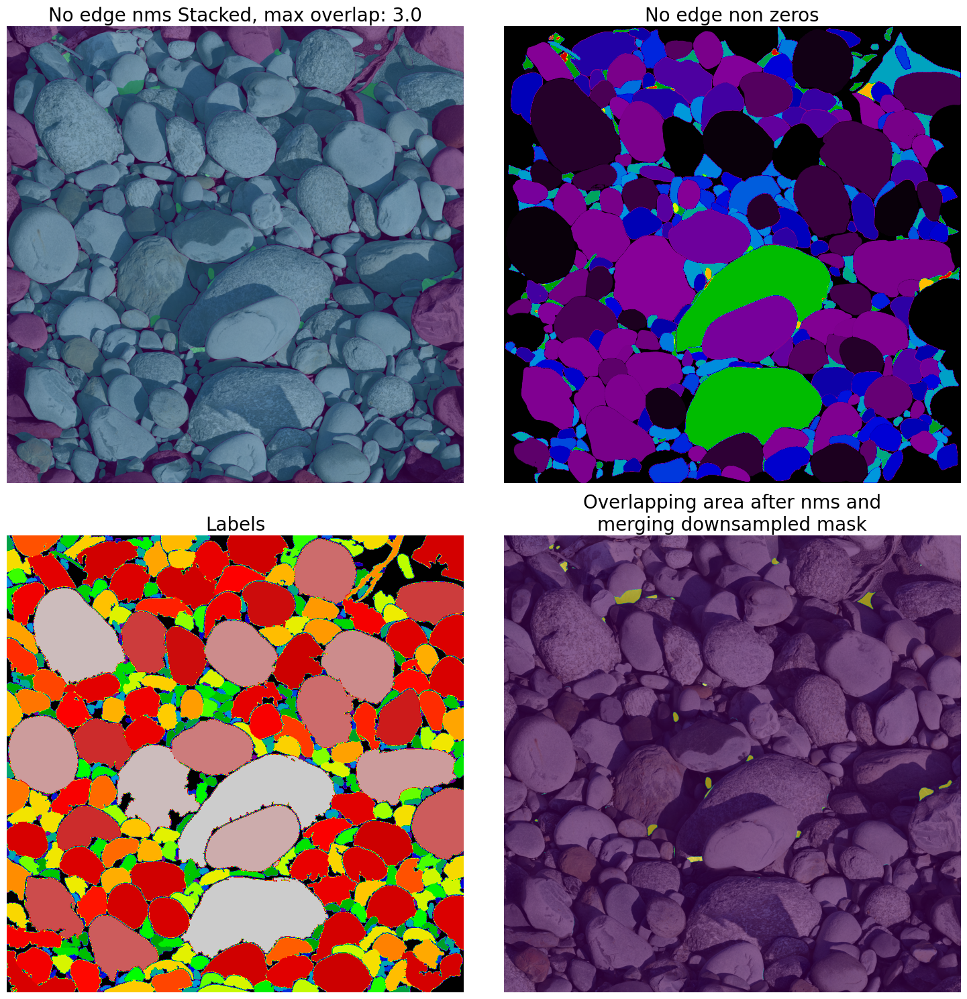

In [30]:
plt.figure(figsize=(15,15))
plt.subplot(2,2,1)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0),alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked, max overlap: {np.max(np.sum(ar_masks,axis=0))}', fontsize=20)

plt.subplot(2,2,2)
plt.imshow(image)
plt.imshow(np.sum([ar_masks[i]*(i+1) for i in range(ar_masks.shape[0])],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.title('No edge non zeros', fontsize=20)

plt.subplot(2,2,3)
plt.imshow(image)
plt.imshow(np.sum([ar_label[i]*(i+1) for i in range(ar_label.shape[0])],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.title('Labels', fontsize=20)

plt.subplot(2,2,4)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0)>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms and\nmerging downsampled mask', fontsize=20)

plt.tight_layout()
plt.show()

In [27]:
tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
k=6
_, ind = tree.query(list_of_label_centroid, k=k)

# get nearest centroid iou
kdc_iou=[]
nearest_mask_pick=[]
labelcount=ar_label.shape[0]
for match in ind:
    #check if nearest neighbor is not a label
    j=1
    while match[j]<labelcount:
        j+=1
        if j==k:
            break
    if j<k:
        if np.sum(ar_label[match[0]])>np.sum(ar_masks[match[j]-labelcount]):
            kdc_iou.append(-fnc.iou(ar_label[match[0]],ar_masks[match[j]-labelcount]))
            nearest_mask_pick.append(match[j])
        else:
            kdc_iou.append(fnc.iou(ar_label[match[0]],ar_masks[match[j]-labelcount]))
            nearest_mask_pick.append(match[j])
    else:
        kdc_iou.append(-0.1)
        nearest_mask_pick.append(0)

In [ ]:
labels_exclude_edge=[]
labels_exclude_edge_idx=[]
for i in range(len(ar_label)):
    if (np.any(ar_label[i][0]==1) or np.any(ar_label[i][-1]==1) or np.any(ar_label[i][:,0]==1) or np.any(ar_label[i][:,-1]==1)):
        labels_exclude_edge.append(False)
    else:
        labels_exclude_edge.append(True)
        labels_exclude_edge_idx.append(i)

fig,ax=plt.subplots(2,1,figsize=(20,15))
ax=ax.flatten()
mean=np.mean(np.array(nearest_centroid_distance)[labels_exclude_edge])
ax[0].scatter(sizes[labels_exclude_edge],np.array(nearest_centroid_distance)[labels_exclude_edge]
            ,label=f'centroid distance (mean: {mean:.2f})')
ax[0].set_ylim(top=150)
ax[0].set_xlabel('grain size (log)', fontsize=20)
ax[0].set_ylabel('distance (px)', fontsize=20)
ax[0].grid()
ax[0].legend()
#ax[1].scatter(np.log10([seg_size[i] for i in seg_size_sort_idx]),avg_iou,label='average iou')
ax[1].scatter(sizes[labels_exclude_edge],max_iou[labels_exclude_edge]
            ,label=f'max iou (abs mean: {round(np.mean(np.abs(max_iou)[labels_exclude_edge]),2)})')
ax[1].scatter(sizes[labels_exclude_edge],kdc_iou[labels_exclude_edge]
            ,label=f'nearest neighbour (mean: {round(np.mean(np.array(kdc_iou)[labels_exclude_edge]),2)})')
ax[1].set_xlabel('grain size (log)', fontsize=20)
ax[1].set_ylabel('iou', fontsize=20)
ax[1].grid()
ax[1].legend()
ax[0].set_title(f'Clip: i{ii},j{ji} Excluding edge objects', fontsize=20)
#plt.savefig(OutDIR+f'clip_{ii}{ji}_dist_iou_plot_noedge.png')
plt.show()

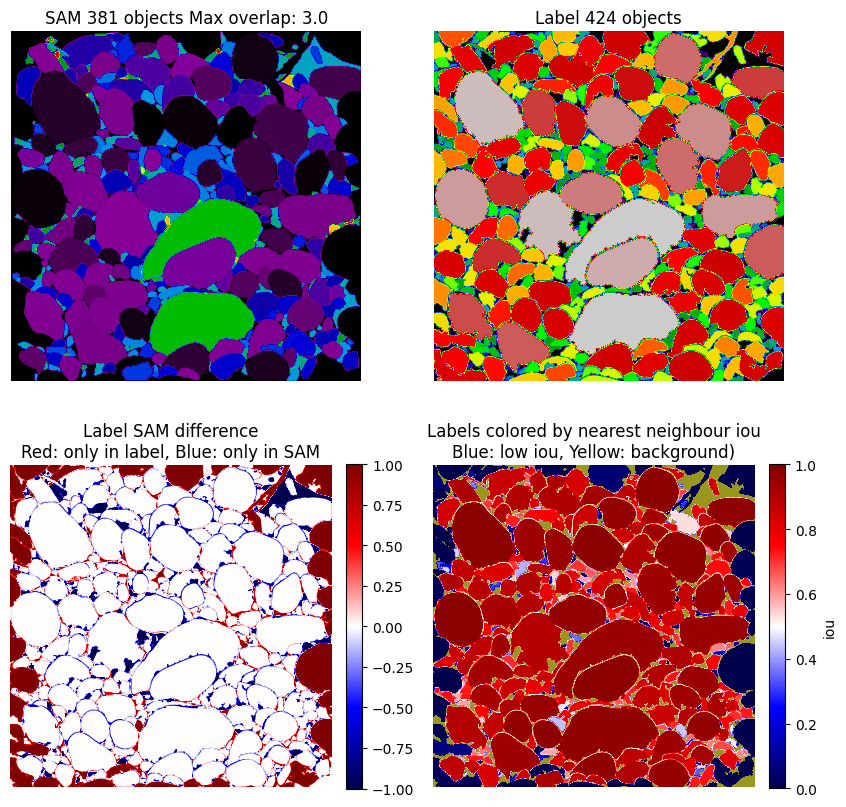

In [28]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(np.sum([ar_masks[i]*(i+1) for i in range(ar_masks.shape[0])],axis=0), cmap='nipy_spectral')
plt.title(f'SAM {ar_masks.shape[0]} objects Max overlap: {np.max(np.sum(ar_masks,axis=0))}')
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(np.sum([ar_label[i]*(i+1) for i in range(labelcount)],axis=0), cmap='nipy_spectral')
plt.title(f'Label {labelcount} objects')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(np.sum(ar_label,axis=0).astype(np.int64)-np.sum(ar_masks,axis=0).astype(np.int64),cmap='seismic',vmax=1,vmin=-1)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Label SAM difference\nRed: only in label, Blue: only in SAM')
plt.axis('off')

plt.subplot(2,2,4)
ar_label_iou=ar_label.copy().astype(np.float64)
for i,x in enumerate(kdc_iou):
    ar_label_iou[i]=ar_label[i]*x

mask = np.isclose(np.sum(ar_label,axis=0),0)
plt.imshow(np.abs(np.sum(ar_label_iou,axis=0)), cmap='seismic',vmax=1,vmin=0)
plt.colorbar(label='iou',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'yellow'])
plt.imshow(mask, cmap=cmap, alpha=0.6)
plt.axis('off')
plt.title('Labels colored by nearest neighbour iou\nBlue: low iou, Yellow: background)')
plt.show()

In [32]:
nearest_centroid_distance=[]
for i in range(labelcount):
    if nearest_mask_pick[i]!=0:
        x0,y0=list_of_label_centroid[i]#label centroid
        x1,y1=list_of_mask_centroid[nearest_mask_pick[i]-labelcount]
        nearest_centroid_distance.append(np.sqrt((x0-x1)**2+(y0-y1)**2))
    else:
        nearest_centroid_distance.append(np.nan)
        print('one nan')

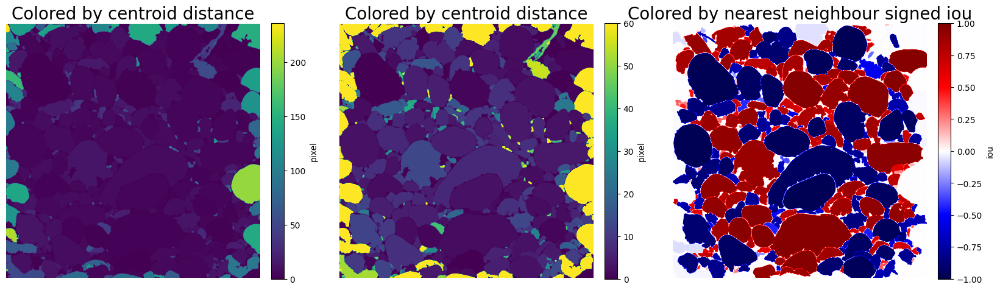

In [33]:
plt.figure(figsize=(20,15))
plt.subplot(1,3,1)
ar_label_dist=ar_label.copy()
for i,x in enumerate(nearest_centroid_distance):
    if not np.isnan(x):
        ar_label_dist[i]=ar_label_dist[i]*x
    else:
        ar_label_dist[i]=ar_label_dist[i]*(-9999)
plt.imshow(np.sum(ar_label_dist,axis=0),vmin=0)
plt.colorbar(label='pixel',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'red'])
mask = np.isclose(np.sum(ar_label,axis=0),-9999)
plt.imshow(mask, cmap=cmap)
plt.axis('off')
plt.title('Colored by centroid distance', fontsize=20)

plt.subplot(1,3,2)
plt.imshow(np.sum(ar_label_dist,axis=0),vmax=60)
plt.colorbar(label='pixel',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'red'])
mask = np.isclose(np.sum(ar_label,axis=0),-9999)
plt.imshow(mask, cmap=cmap)
plt.axis('off')
plt.title('Colored by centroid distance', fontsize=20)
del ar_label_dist

plt.subplot(1,3,3)
ar_label_iou=ar_label.copy().astype(np.float64)
for i,x in enumerate(kdc_iou):
    ar_label_iou[i]=ar_label[i]*x
plt.imshow(np.sum(ar_label_iou,axis=0), cmap='seismic',vmax=1,vmin=-1)
plt.colorbar(label='iou',fraction=0.046, pad=0.04)
plt.axis('off')
plt.title('Colored by nearest neighbour signed iou', fontsize=20)
plt.show()

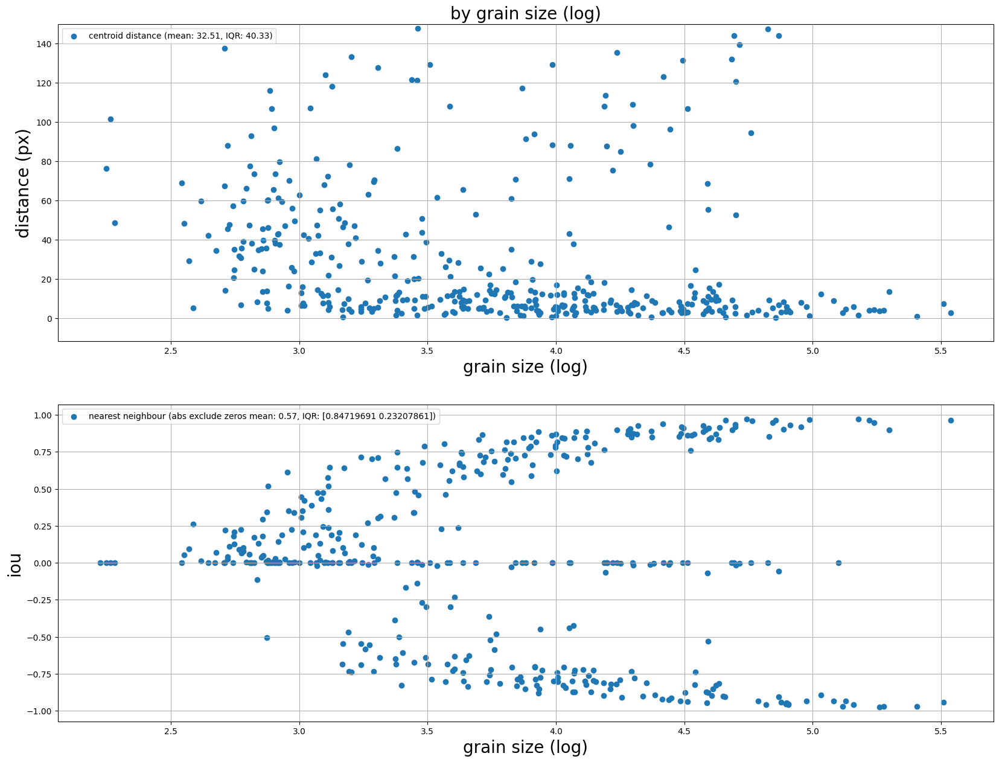

In [44]:
kdc_iou=np.array(kdc_iou)
sizes=np.log10([seg_size[i] for i in seg_size_sort_idx])

fig,ax=plt.subplots(2,1,figsize=(20,15))
ax=ax.flatten()
ax[0].scatter(sizes,np.array(nearest_centroid_distance),label=f'centroid distance (mean: {np.nanmean(nearest_centroid_distance):.2f}, IQR: {np.subtract(*np.percentile(nearest_centroid_distance, [75, 25])):.2f})')
ax[0].set_ylim(top=150)
ax[0].set_xlabel('grain size (log)', fontsize=20)
ax[0].set_ylabel('distance (px)', fontsize=20)
ax[0].grid()
ax[0].legend()
ax[1].scatter(sizes,kdc_iou,label=f'nearest neighbour (abs exclude zeros mean: {round(np.mean(np.abs(kdc_iou[kdc_iou!=0])),2)}, IQR: {np.percentile(np.abs(kdc_iou[kdc_iou!=0]), [75, 25])})')
ax[1].set_xlabel('grain size (log)', fontsize=20)
ax[1].set_ylabel('iou', fontsize=20)
ax[1].grid()
ax[1].legend()
ax[0].set_title('by grain size (log)', fontsize=20)
plt.show()

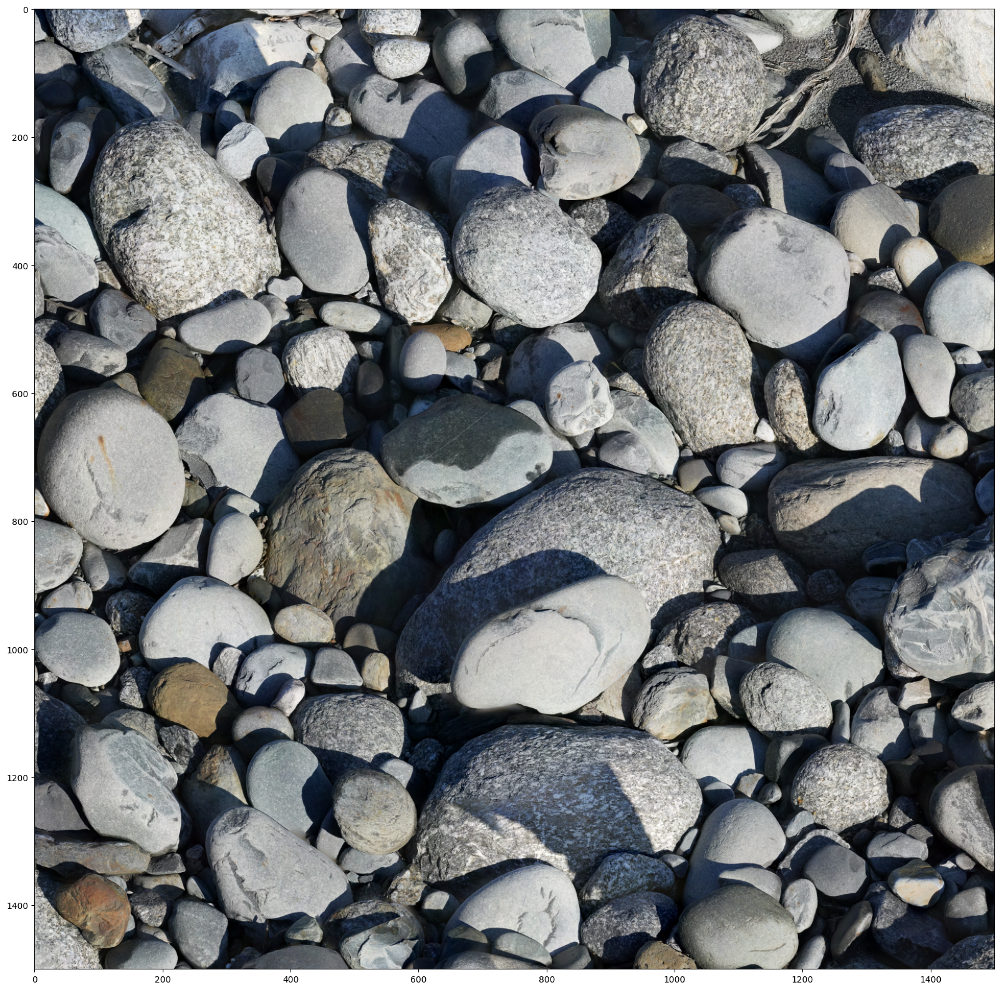

In [39]:
plt.figure(figsize=(20,20))
plt.imshow(image)

In [40]:
#clip

model_list=clip.available_models()
print('Available clip models:')
for i, M in enumerate(model_list):
    print(f'{i}:' + M)
print("---------------")

Available clip models:
0:RN50
1:RN101
2:RN50x4
3:RN50x16
4:RN50x64
5:ViT-B/32
6:ViT-B/16
7:ViT-L/14
8:ViT-L/14@336px
---------------


In [41]:
#model_select=int(input("Select a model: "))
model_select=7
model, preprocess = clip.load(model_list[model_select], device=DEVICE)
print(model_list[model_select]+' loaded')

ViT-L/14 loaded


In [42]:
kmean_mask=np.array(np.reshape(cluster_labels,(crop_size,crop_size)) == 0)
kmean_masked_img=cropped_image.copy()
kmean_masked_img[kmean_mask==0]=0

NameError: name 'cluster_labels' is not defined

In [ ]:
labels_LSet01=["an aerial photo of a stone", "an aerial photo of a small pebble stone"
        , "an aerial photo of a piece of sand surface"
        , "an aerial photo of some green plants", "dead bush"
        , "an aerial photo of a shrub","an irregular green object", "a top-down photo of a bush", "an aerial photo of a bush"
        , "a top-down photo of a shrub", "an aerial photo of some bushes", "wood stick", "wood branch"
        , "an aerial photo of desert surface", "an aerial photo of a sandy ground"
        , "a photo of the top of a bush", "an aerial photo of a small bush"]

In [ ]:
labels_LSet01=["a photo of a stone", "a photo of a wood stick","wood branch"]

In [43]:
##label top

kmean_apply=False
WithBackground=False
BG='White'
#BG='Black

if (not WithBackground) or kmean_apply:
    if BG=='White':
        fill_value=255
    else:
        fill_value=0

#load image
pil_image = Image.fromarray(image)
numpy_array = np.array(pil_image)
if kmean_apply:
    numpy_array[kmean_mask==0]=fill_value

#define possible labels
labels=["a photo of a stone", "a photo of a wood stick","wood branch"]
text = clip.tokenize(labels).to(DEVICE)

#output
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(image.shape[:-1])
    
#run prediction
for sg in tqdm(range(ar_masks.shape[0]), desc='Processing', unit='segment'):
    sg_mask=ar_masks[sg]
    
    #cropping
    notzero_indices = np.nonzero(sg_mask)
    if notzero_indices[0].shape[0]>10:
        x_min = np.min(notzero_indices[0]).astype(int)
        x_max = np.max(notzero_indices[0]).astype(int)
        y_min = np.min(notzero_indices[1]).astype(int)
        y_max = np.max(notzero_indices[1]).astype(int)
        if WithBackground:
            clip_masked_image=numpy_array[x_min-5:x_max+5, y_min-5:y_max+5,:]
        else:
            #masking
            masked_image = np.copy(numpy_array)
            masked_image[sg_mask == 0] = fill_value
            clip_masked_image=masked_image[x_min-5:x_max+5, y_min-5:y_max+5,:]

        #convert back to PIL
        if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
            preprocessed_pil_image = Image.fromarray(clip_masked_image)

            #predict
            pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
            most_porbable, probability = fnc.classify_and_return_notable(pre_image, text, labels, model)
            most_probables.append(int(most_porbable))
            probabilities.append(probability)
            
            if int(most_porbable)<=1:
                clip_probability_mask[sg_mask!=0]=probability
        else:
            most_probables.append(np.nan)
            probabilities.append(np.nan)

Processing:   0%|          | 0/228 [00:00<?, ?segment/s]

/DATA/vito/.venv/lib/python3.8/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
Processing: 100%|██████████| 228/228 [00:19<00:00, 11.85segment/s]


In [44]:
non_rocks_mask=[ar_masks[i] for i in range(ar_masks.shape[0]) if most_probables[i]!=0]

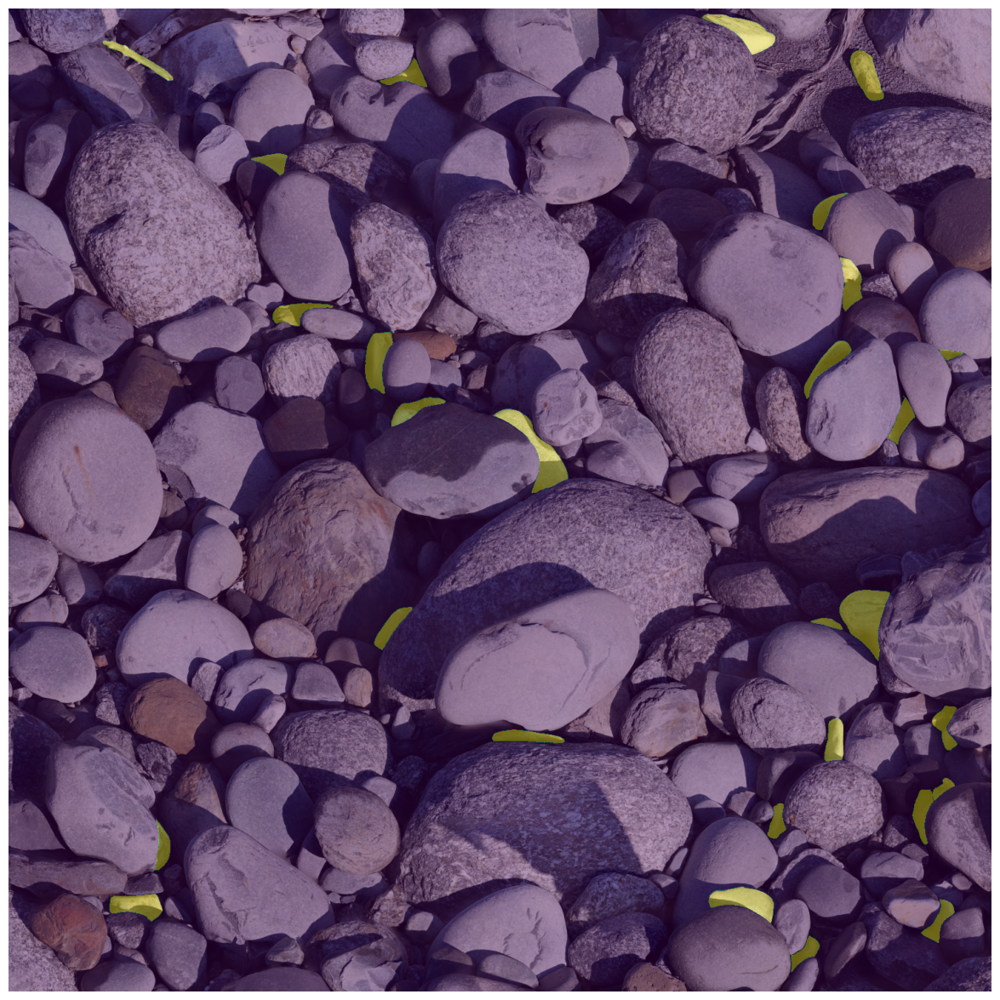

In [45]:
plt.figure(figsize=(15,15))
plt.imshow(image)
plt.imshow(np.sum(non_rocks_mask,axis=0),alpha=0.4)
plt.axis('off')
plt.show()

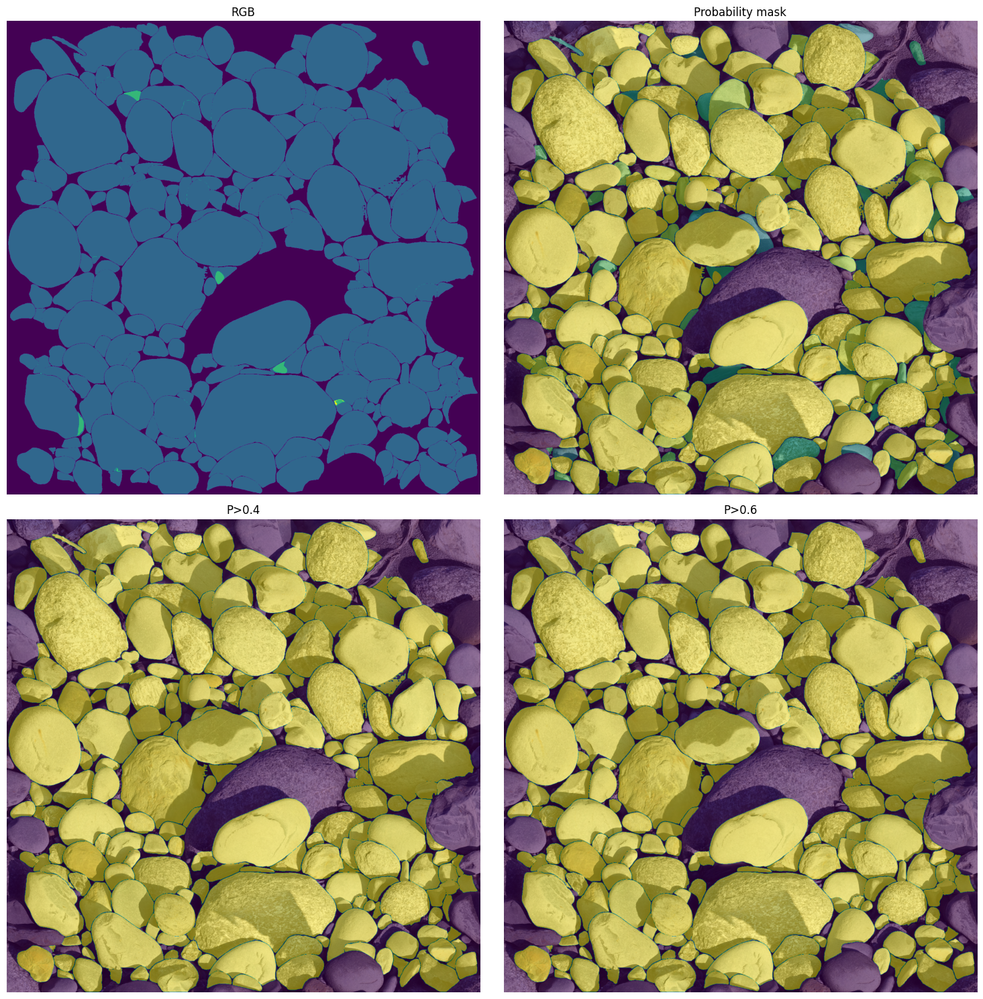

In [46]:
fnc.clip_plotting_array(image,clip_probability_mask, ar_masks,0.4,0.6)